In [1]:
#Import Libraries

#import Visualization, pandas and numpy libraries
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.colors import ListedColormap
import math
# Os tools
import os
import gc
import zipfile

In [2]:
# Supress Warnings
import warnings
warnings.filterwarnings('ignore')
# Import Planetary Computer tools
from pystac.extensions.raster import RasterExtension as raster
import planetary_computer as pc
import pystac_client
import stackstac
# Import common GIS tools
import folium
import rasterio.features
import rioxarray as rio
import matplotx
import xarray as xr
from itertools import cycle

In [3]:
# Storage Path
storage_path = './output/'
if not os.path.exists(storage_path):
    os.mkdir(storage_path)

# Path to data folder 
data_path = '/Users/seyi/Documents/WLV/project/JUPYTER/DATA/'


In [4]:
#Read model Data from CSV
occurence_data = pd.read_csv(storage_path+'model_data_csv',sep='\t')

In [5]:
occurence_data.describe()


,Unnamed: 0,gbifID,decimalLatitude,decimalLongitude,key,landcover,elevation,gradient,change,extent,...,B02,B08,q_mean,vap_mean,tmax_max,tmax_mean,tmin_min,tmin_mean,ppt_mean,soil_mean
count,9214.000000,9.214000e+03,9214.000000,9214.000000,9214.000000,9214.000000,9214.000000,9214.000000,9214.000000,9214.000000,...,9214.00000,9214.00000,9214.000000,9214.000000,9214.000000,9214.000000,9214.000000,9214.000000,9214.000000,9214.000000
mean,5062.256241,2.848292e+09,-27.855634,126.785179,5062.256241,4.615639,61.163261,3.272887,246.244248,0.011776,...,663.18282,2614.80980,25.572505,1.579273,31.033190,24.440243,8.335350,13.682134,104.379910,119.992235
std,3094.298760,8.961176e+08,13.619628,56.751480,3094.298760,2.153341,77.584543,4.770901,27.886290,0.107754,...,941.18291,911.21325,36.799316,0.618666,3.088585,5.005354,5.413753,5.070511,55.049596,80.803415
min,0.000000,2.237840e+08,-37.999739,-84.190000,0.000000,1.000000,0.000000,0.000000,55.000000,0.000000,...,46.50000,3.00000,2.481944,0.914222,18.100000,14.808889,1.000000,6.395417,47.734722,5.454167
25%,2305.250000,1.990519e+09,-37.776647,131.089000,2305.250000,2.000000,12.455258,0.614247,253.000000,0.000000,...,246.50000,2105.00000,5.709722,1.092486,28.699999,20.350972,4.300000,9.459305,66.681944,56.741667
50%,4611.500000,3.463472e+09,-31.798150,145.263379,4611.500000,5.000000,39.648338,1.705221,253.000000,0.000000,...,386.00000,2488.00000,12.502778,1.297945,29.799999,23.933194,5.700000,11.829583,85.420833,96.066667
75%,7841.750000,3.463610e+09,-16.809800,145.558039,7841.750000,7.000000,74.086000,4.171558,253.000000,0.000000,...,610.00000,2839.50000,25.165278,2.234389,33.880001,28.242083,14.400000,19.147916,126.083333,159.788890
max,10371.000000,3.469585e+09,10.594964,152.900000,10371.000000,8.000000,1553.022827,66.918785,253.000000,1.000000,...,10621.00000,10328.00000,189.986111,3.024153,37.799999,33.813471,21.500000,22.688750,297.587500,382.051403


In [6]:
occurence_data.mean(axis=0)


Unnamed: 0          5.062256e+03
gbifID              2.848292e+09
decimalLatitude    -2.785563e+01
decimalLongitude    1.267852e+02
key                 5.062256e+03
landcover           4.615639e+00
elevation           6.116326e+01
gradient            3.272887e+00
change              2.462442e+02
extent              1.177556e-02
occurrence          7.319839e-01
recurrence          1.160300e+00
seasonality         9.094856e-02
transitions         4.661385e-02
B04                 8.574389e+02
B03                 8.469223e+02
B02                 6.631828e+02
B08                 2.614810e+03
q_mean              2.557250e+01
vap_mean            1.579273e+00
tmax_max            3.103319e+01
tmax_mean           2.444024e+01
tmin_min            8.335350e+00
tmin_mean           1.368213e+01
ppt_mean            1.043799e+02
soil_mean           1.199922e+02
dtype: float64

In [7]:
occurence_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9214 entries, 0 to 9213
Data columns (total 31 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Unnamed: 0        9214 non-null   int64  
 1   gbifID            9214 non-null   int64  
 2   eventDate         9214 non-null   object 
 3   country           9214 non-null   object 
 4   continent         9214 non-null   object 
 5   stateProvince     9214 non-null   object 
 6   decimalLatitude   9214 non-null   float64
 7   decimalLongitude  9214 non-null   float64
 8   species           9214 non-null   object 
 9   key               9214 non-null   int64  
 10  landcover         9214 non-null   float64
 11  elevation         9214 non-null   float64
 12  gradient          9214 non-null   float64
 13  change            9214 non-null   float64
 14  extent            9214 non-null   float64
 15  occurrence        9214 non-null   float64
 16  recurrence        9214 non-null   float64


In [8]:
occurence_data.head()

,Unnamed: 0,gbifID,eventDate,country,continent,stateProvince,decimalLatitude,decimalLongitude,species,key,...,B02,B08,q_mean,vap_mean,tmax_max,tmax_mean,tmin_min,tmin_mean,ppt_mean,soil_mean
0,0,2818667399,2014-01-16 13:30:00,Australia,Australia,New South Wales,-31.804450,152.728649,Litoria Fallax,0,...,634.0,2233.0,13.177778,1.550111,30.199999,24.438333,6.6,13.927083,102.280556,118.294446
1,1,1071587460,2005-10-18 00:00:00,Australia,Australia,New South Wales,-31.458809,152.872052,Litoria Fallax,1,...,1057.0,2636.5,17.879167,1.569250,29.900000,24.355694,6.6,13.924305,109.455556,116.466668
2,2,2806337299,2020-04-14 00:00:00,Australia,Australia,New South Wales,-31.467921,152.873221,Crinia Signifera,2,...,395.0,2543.5,17.879167,1.569250,29.900000,24.355694,6.6,13.924305,109.455556,116.466668
3,3,1072127779,1995-01-06 00:00:00,Australia,Australia,New South Wales,-31.752803,152.585086,Litoria Fallax,3,...,2104.0,4505.0,14.020833,1.484264,30.400000,24.374999,6.1,13.283333,103.538889,123.972225
4,4,1072032944,2003-07-23 00:00:00,Australia,Australia,New South Wales,-31.592781,152.837717,Crinia Signifera,4,...,258.5,2140.0,17.212500,1.572153,30.099998,24.438055,7.0,14.099444,109.850000,116.381947


In [9]:
global_landcover_mapper = {
    1:  'glc_water',
    2:  'glc_trees',
    3:  'glc_grass',
    4:  'glc_flooded_vegetation',
    5:  'glc_crops',
    6:  'glc_scrub',
    7:  'glc_urban',
    8:  'glc_bare_soil',
    9:  'glc_snow_ice',
    10: 'glc_clouds'
}
surface_water_transitions_mapper = {
    1:  "sw_tran_permanent",
    2:  "sw_tran_new_permanent",
    3:  "sw_tran_lost_permanent",
    4:  "sw_tran_seasonal",
    5:  "sw_tran_new_seasonal",
    6:  "sw_tran_lost_seasonal",
    7:  "sw_tran_seasonal_to_permanent",
    8:  "sw_tran_permanent_to_seasonal",
    9:  "sw_tran_ephemeral_permanent",
    10: "sw_tran_ephemeral_seasonal"
}


In [10]:
occurence_data.groupby('species')[
    'tmax_mean'].mean().sort_values(ascending=False)


species
Ranoidea Australis           33.359154
Dendrobates Auratus          31.412532
Agalychnis Callidryas        31.182344
Chiromantis Xerampelina      28.476826
Austrochaperina Pluvialis    28.035418
Litoria Fallax               26.185890
Xenopus Laevis               26.117770
Crinia Glauerti              24.645508
Crinia Signifera             20.627591
Name: tmax_mean, dtype: float64

In [11]:
occurence_data.species.value_counts().sort_values(ascending=False)


Crinia Signifera             4994
Litoria Fallax               1363
Ranoidea Australis           1252
Crinia Glauerti               646
Agalychnis Callidryas         314
Austrochaperina Pluvialis     301
Dendrobates Auratus           279
Chiromantis Xerampelina        46
Xenopus Laevis                 19
Name: species, dtype: int64

In [12]:
occurence_data.groupby('species')[
    'ppt_mean'].mean().sort_values(ascending=False)


species
Agalychnis Callidryas        265.644259
Dendrobates Auratus          261.189436
Austrochaperina Pluvialis    188.993743
Ranoidea Australis           127.794643
Litoria Fallax               126.909248
Crinia Signifera              75.682191
Xenopus Laevis                69.586330
Chiromantis Xerampelina       63.526691
Crinia Glauerti               51.714856
Name: ppt_mean, dtype: float64

In [13]:
occurence_data.groupby('species')[
    'q_mean'].mean().sort_values(ascending=False)

species
Agalychnis Callidryas        149.252968
Dendrobates Auratus          145.338296
Austrochaperina Pluvialis     74.135401
Litoria Fallax                33.377283
Ranoidea Australis            25.456959
Crinia Signifera               8.816241
Crinia Glauerti                6.614727
Xenopus Laevis                 3.976974
Chiromantis Xerampelina        3.329408
Name: q_mean, dtype: float64

In [14]:
occurence_data.groupby('species')[
    'seasonality'].mean().sort_values(ascending=False)


species
Agalychnis Callidryas        0.235669
Crinia Signifera             0.116740
Chiromantis Xerampelina      0.108696
Dendrobates Auratus          0.093190
Litoria Fallax               0.063096
Ranoidea Australis           0.051118
Austrochaperina Pluvialis    0.000000
Crinia Glauerti              0.000000
Xenopus Laevis               0.000000
Name: seasonality, dtype: float64

In [15]:
occurence_data.groupby('country')[
    'species'].value_counts().sort_values(ascending=False)

country       species                  
Australia     Crinia Signifera             4994
              Litoria Fallax               1363
              Ranoidea Australis           1252
              Crinia Glauerti               646
Costa Rica    Agalychnis Callidryas         314
Australia     Austrochaperina Pluvialis     301
Costa Rica    Dendrobates Auratus           279
South Africa  Chiromantis Xerampelina        46
              Xenopus Laevis                 19
Name: species, dtype: int64

In [16]:
occurence_data.groupby('species')[
    'occurrence'].mean().sort_values(ascending=False)

species
Agalychnis Callidryas        1.764331
Chiromantis Xerampelina      1.586957
Crinia Signifera             0.921105
Dendrobates Auratus          0.758065
Litoria Fallax               0.557594
Ranoidea Australis           0.399361
Austrochaperina Pluvialis    0.112957
Crinia Glauerti              0.018576
Xenopus Laevis               0.000000
Name: occurrence, dtype: float64

In [17]:
occurence_data.groupby('species')[
    'change'].mean().sort_values(ascending=False)

species
Xenopus Laevis               253.000000
Crinia Glauerti              252.608359
Austrochaperina Pluvialis    252.202658
Ranoidea Australis           251.714856
Litoria Fallax               251.316948
Crinia Signifera             251.008811
Chiromantis Xerampelina      249.760870
Dendrobates Auratus          180.537634
Agalychnis Callidryas        165.288217
Name: change, dtype: float64

In [18]:
pd.set_option('display.max_rows', None)
occurence_data.groupby('species')[
    'landcover'].value_counts().sort_values(ascending=False)


species                    landcover
Crinia Signifera           2.0          1626
                           7.0          1579
                           3.0           751
Ranoidea Australis         6.0           552
                           7.0           535
Litoria Fallax             7.0           522
Crinia Glauerti            7.0           480
Crinia Signifera           5.0           422
Litoria Fallax             2.0           374
Crinia Signifera           4.0           365
Agalychnis Callidryas      2.0           244
Crinia Signifera           6.0           180
Dendrobates Auratus        2.0           176
Austrochaperina Pluvialis  2.0           153
Litoria Fallax             3.0           149
                           5.0           125
                           6.0           105
Austrochaperina Pluvialis  7.0            75
Litoria Fallax             4.0            71
Ranoidea Australis         2.0            64
Crinia Signifera           1.0            60
Crinia Glauerti   

Text(0.5, 1.0, 'Frog species occurence')

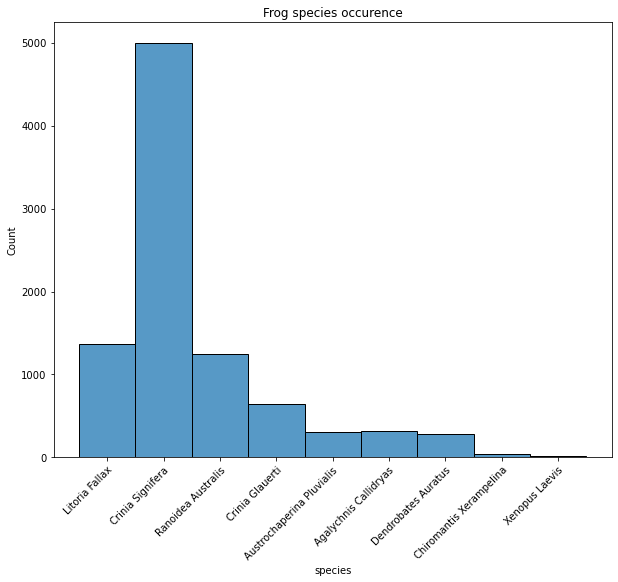

In [19]:
fig = plt.figure(figsize=(10, 8))
sns.histplot(occurence_data['species'])
plt.xticks(rotation=45, ha='right', va='top', rotation_mode='anchor')
plt.title('Frog species occurence')

Text(0.5, 1.0, 'Distribution of Amphibian species occurence')

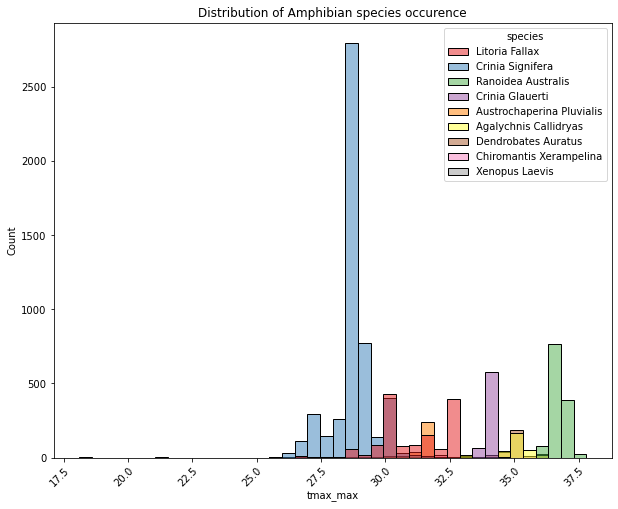

In [20]:
fig = plt.figure(figsize=(10, 8))
sns.histplot(data=occurence_data, x='tmax_max',
             hue='species', palette='Set1')
plt.xticks(rotation=45, ha='right', va='top', rotation_mode='anchor')
plt.title('Distribution of Amphibian species occurence')


Text(0.5, 1.0, 'Distribution of Amphibian species occurence')

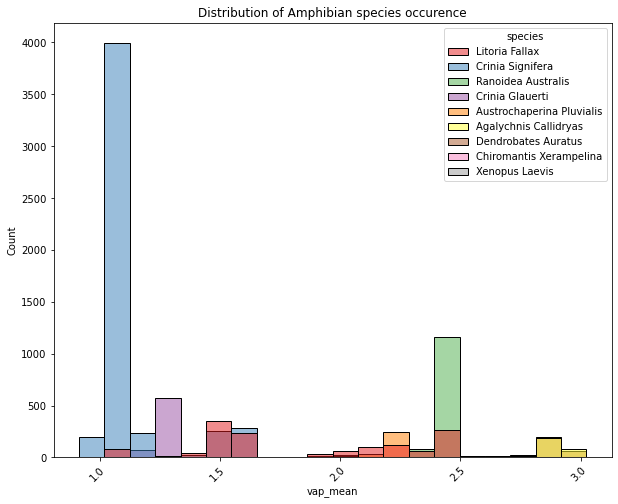

In [21]:
fig = plt.figure(figsize=(10, 8))
sns.histplot(data=occurence_data, x='vap_mean', hue='species', palette='Set1')
plt.xticks(rotation=45, ha='right', va='top', rotation_mode='anchor')
plt.title('Distribution of Amphibian species occurence')


In [24]:
#plt.style.use('ggplot')#
colourmap_species = {
    'Litoria Fallax': '#e41a1c', #red
    'Crinia Signifera': '#377eb8', #bluue
    'Ranoidea Australis': '#4daf4a',#green
    'Crinia Glauerti': '#984ea3',#purple
    'Dendrobates Auratus': '#a65628',# brown
    'Chiromantis Xerampelina': '#f781bf',#pink
    'Austrochaperina Pluvialis': '#ff7f00',#orange
    'Xenopus Laevis': '#999999',#gray
    'Agalychnis Callidryas': '#ffff33'#yellow
}


In [25]:

# Plotting functions
def plotDot(point, folium_map, species_colours):
    folium.CircleMarker(
        location=[point.decimalLatitude, point.decimalLongitude],
        stroke=False,
        weight=15,
        opacity=1.0,
        radius=7, 
        color=colourmap_species[point.species],
        fill=True, 
        fill_color=colourmap_species[point.species],
        fill_opacity=0.7
    ).add_to(m)


def _degree_to_zoom_level(l1, l2, margin=0.0):

    degree = abs(l1 - l2) * (1 + margin)
    zoom_level_int = 0
    if degree != 0:
        zoom_level_float = math.log(360/degree)/math.log(2)
        zoom_level_int = int(zoom_level_float)
    else:
        zoom_level_int = 18
    return zoom_level_int


def display_map(latitude=None, longitude=None):

    margin = -0.5
    zoom_bias = 0
    lat_zoom_level = _degree_to_zoom_level(
        margin=margin, *latitude) + zoom_bias
    lon_zoom_level = _degree_to_zoom_level(
        margin=margin, *longitude) + zoom_bias
    zoom_level = min(lat_zoom_level, lon_zoom_level)
    center = [np.mean(latitude), np.mean(longitude)]

    map_hybrid = folium.Map(location=center, zoom_start=zoom_level,control_scale=False, prefer_canvas=True,
                            zoom_control=False, scrollWheelZoom=False,
                            tiles="http://mt1.google.com/vt/lyrs=y&z={z}&x={x}&y={y}", attr="Google")

    line_segments = [(latitude[0], longitude[0]), (latitude[0], longitude[1]),
                     (latitude[1], longitude[1]), (latitude[1], longitude[0]),
                     (latitude[0], longitude[0])]

    map_hybrid.add_child(folium.features.PolyLine(
        locations=line_segments, color='red', opacity=0.8))
    map_hybrid.add_child(folium.features.LatLngPopup())

    return map_hybrid


In [26]:
# Port Macquarie, Australia
region_name = 'Port Macquarie, Australia'
min_lon, min_lat = (152.4,  -31.9)  # Lower-left corner (longitude, latitude)
max_lon, max_lat = (152.9, -31.4)  # Upper-right corner (longitude, latitude)
bbox = (min_lon, min_lat, max_lon, max_lat)
latitude = (min_lat, max_lat)
longitude = (min_lon, max_lon)

# Plot bounding box on a map
f = folium.Figure(width=600, height=600)
m = display_map(latitude, longitude)
(
    occurence_data[occurence_data.country == 'Australia']
).apply(
    plotDot, axis=1, args=(m, colourmap_species)
)

f.add_child(m)
#create a map


In [27]:
#Victoria, Australia
region_name = 'Victoria, Australia'
# Lower-left corner (longitude, latitude)
min_lon, min_lat = (145.125, -38)
max_lon, max_lat = (145.625, -37.5)  # Upper-right corner (longitude, latitude)
bbox = (min_lon, min_lat, max_lon, max_lat)
latitude = (min_lat, max_lat)
longitude = (min_lon, max_lon)

# Plot bounding box on a map
f = folium.Figure(width=600, height=600)
m = display_map(latitude, longitude)
(
    occurence_data[occurence_data.country == 'Australia']
).apply(
    plotDot, axis=1, args=(m, colourmap_species)
)

f.add_child(m)
#create a map


In [28]:
#Darwin, Australia
region_name = 'Darwin, Australia'
# Lower-left corner (longitude, latitude)
min_lon, min_lat = (130.9, -12.8)
max_lon, max_lat = (131.4, -12.3)  # Upper-right corner (longitude, latitude)
bbox = (min_lon, min_lat, max_lon, max_lat)
latitude = (min_lat, max_lat)
longitude = (min_lon, max_lon)

# Plot bounding box on a map
f = folium.Figure(width=600, height=600)
m = display_map(latitude, longitude)
(
    occurence_data[occurence_data.country == 'Australia']
).apply(
    plotDot, axis=1, args=(m, colourmap_species)
)

f.add_child(m)
#create a map


In [29]:
#Western Australia, Australia
region_name = 'Western Australia, Australia'
# Lower-left corner (longitude, latitude)
min_lon, min_lat = (115.9, -31.8)
max_lon, max_lat = (116.4, -31.3)  # Upper-right corner (longitude, latitude)
bbox = (min_lon, min_lat, max_lon, max_lat)
latitude = (min_lat, max_lat)
longitude = (min_lon, max_lon)

# Plot bounding box on a map
f = folium.Figure(width=600, height=600)
m = display_map(latitude, longitude)
(
    occurence_data[occurence_data.country == 'Australia']
).apply(
    plotDot, axis=1, args=(m, colourmap_species)
)

f.add_child(m)
#create a map


In [30]:
#Queensland, Australia
region_name = 'Queensland, Australia'
# Lower-left corner (longitude, latitude)
min_lon, min_lat = (145.2021, -17.2385)
# Upper-right corner (longitude, latitude)
max_lon, max_lat = (145.7021, -16.7385)
bbox = (min_lon, min_lat, max_lon, max_lat)
latitude = (min_lat, max_lat)
longitude = (min_lon, max_lon)

# Plot bounding box on a map
f = folium.Figure(width=600, height=600)
m = display_map(latitude, longitude)
(
    occurence_data[occurence_data.country == 'Australia']
).apply(
    plotDot, axis=1, args=(m, colourmap_species)
)

f.add_child(m)
#create a map

In [31]:
#Puntarenas Province, Costa Rica
region_name = 'Puntarenas Province, Costa Rica'
min_lon, min_lat = (-83.75, 8.35)  # Lower-left corner (longitude, latitude)
max_lon, max_lat = (-83.25, 8.85)  # Upper-right corner (longitude, latitude)
bbox = (min_lon, min_lat, max_lon, max_lat)
latitude = (min_lat, max_lat)
longitude = (min_lon, max_lon)

# Plot bounding box on a map
f = folium.Figure(width=600, height=600)
m = display_map(latitude, longitude)
(
    occurence_data[occurence_data.country == 'Costa Rica']
).apply(
    plotDot, axis=1, args=(m, colourmap_species)
)

f.add_child(m)

In [32]:
#Puntarenas Province, Costa Rica
region_name = 'Heredia Province, Costa Rica'
# Lower-left corner (longitude, latitude)
min_lon, min_lat = (-84.1905, 9.9575)
# Upper-right corner (longitude, latitude)
max_lon, max_lat = (-83.703833, 10.703667)
bbox = (min_lon, min_lat, max_lon, max_lat)
latitude = (min_lat, max_lat)
longitude = (min_lon, max_lon)

# Plot bounding box on a map
f = folium.Figure(width=600, height=600)
m = display_map(latitude, longitude)
(
    occurence_data[occurence_data.country == 'Costa Rica']
).apply(
    plotDot, axis=1, args=(m, colourmap_species)
)

f.add_child(m)

In [33]:
#Hluhluwe, South Africa
region_name = 'Hluhluwe, South Africa'
min_lon, min_lat = (32.00, -28.1)  # Lower-left corner (longitude, latitude)
max_lon, max_lat = (32.50, -27.6)  # Upper-right corner (longitude, latitude)
bbox = (min_lon, min_lat, max_lon, max_lat)
latitude = (min_lat, max_lat)
longitude = (min_lon, max_lon)

# Plot bounding box on a map
f = folium.Figure(width=600, height=600)
m = display_map(latitude, longitude)
(
    occurence_data[occurence_data.country == 'South Africa']
).apply(
    plotDot, axis=1, args=(m, colourmap_species)
)

f.add_child(m)


In [34]:
#KwaZulu-Natal Province, South Africa
region_name = 'KwaZulu-Natal Province, South Africa'
# Lower-left corner (longitude, latitude)
min_lon, min_lat = (30.19, -29.52)
# Upper-right corner (longitude, latitude)
max_lon, max_lat = (30.69, -29.02)
bbox = (min_lon, min_lat, max_lon, max_lat)
latitude = (min_lat, max_lat)
longitude = (min_lon, max_lon)

# Plot bounding box on a map
f = folium.Figure(width=600, height=600)
m = display_map(latitude, longitude)
(
    occurence_data[occurence_data.country == 'South Africa']
).apply(
    plotDot, axis=1, args=(m, colourmap_species)
)
f.add_child(m)

In [35]:
#KwaZulu-Natal Province, South Africa
region_name = 'Eshowe, South Africa'
# Lower-left corner (longitude, latitude)
min_lon, min_lat = (31.46, -28.90) 
# Upper-right corner (longitude, latitude)
max_lon, max_lat = (31.96, -28.40)
bbox = (min_lon, min_lat, max_lon, max_lat)
latitude = (min_lat, max_lat)
longitude = (min_lon, max_lon)

# Plot bounding box on a map
f = folium.Figure(width=600, height=600)
m = display_map(latitude, longitude)
(
    occurence_data[occurence_data.country == 'South Africa']
).apply(
    plotDot, axis=1, args=(m, colourmap_species)
)
f.add_child(m)


[Text(0, 0, 'Litoria Fallax'),
 Text(1, 0, 'Crinia Signifera'),
 Text(2, 0, 'Ranoidea Australis'),
 Text(3, 0, 'Crinia Glauerti'),
 Text(4, 0, 'Austrochaperina Pluvialis'),
 Text(5, 0, 'Agalychnis Callidryas'),
 Text(6, 0, 'Dendrobates Auratus'),
 Text(7, 0, 'Chiromantis Xerampelina'),
 Text(8, 0, 'Xenopus Laevis')]

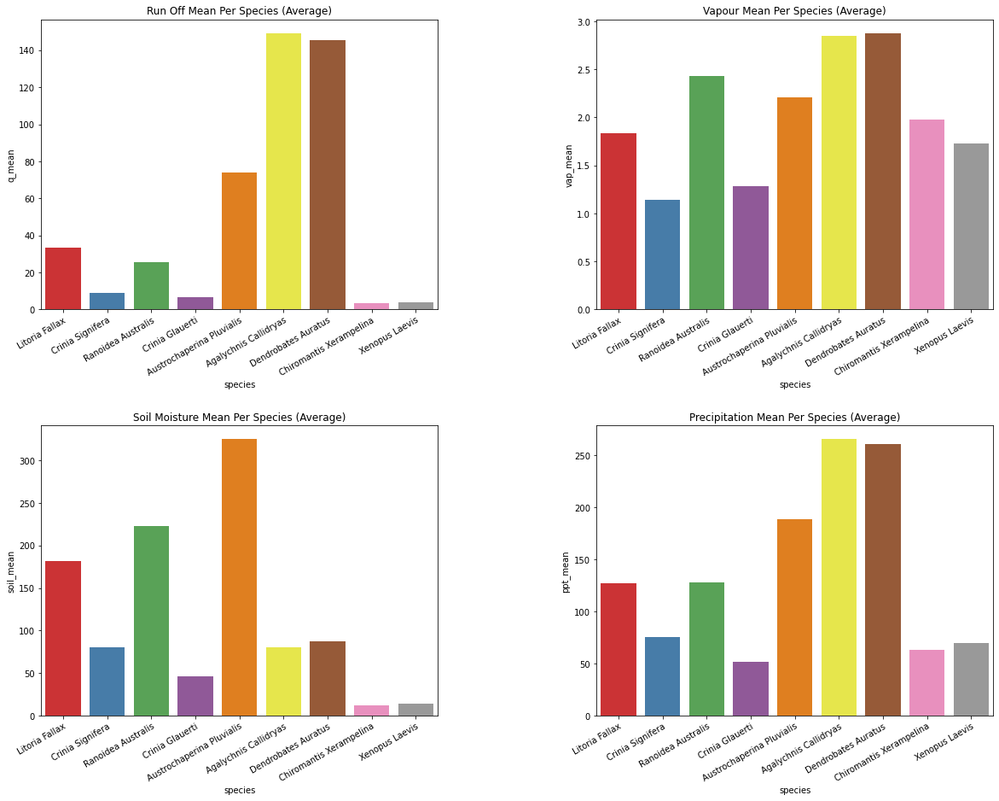

In [36]:
#order = occurence_data.groupby('species')['q_mean'].mean().sort_values(ascending=True).index
fig, ax = plt.subplots(2, 2, figsize=(20, 15))
plt.subplots_adjust(hspace=0.4, wspace=0.4)
sns.barplot(data = occurence_data, x = 'species', y = 'q_mean',
            estimator=np.mean, ci=None, ax=ax[0,0], palette = 'Set1')
ax[0, 0].set_title('Run Off Mean Per Species (Average)')
ax[0, 0].set_xticklabels(list(occurence_data.species.unique()), rotation=30,
                         ha='right', va='top', rotation_mode='anchor')

sns.barplot(data=occurence_data, x='species', y='vap_mean',
            estimator=np.mean, ci=None, ax=ax[0, 1], palette='Set1')
ax[0, 1].set_title('Vapour Mean Per Species (Average)')
ax[0, 1].set_xticklabels(list(occurence_data.species.unique()), rotation=30,
                         ha='right', va='top', rotation_mode='anchor')

sns.barplot(data=occurence_data, x='species', y='soil_mean',
            estimator=np.mean, ci=None, ax=ax[1, 0], palette='Set1')
ax[1, 0].set_title('Soil Moisture Mean Per Species (Average)')
ax[1, 0].set_xticklabels(list(occurence_data.species.unique()), rotation=30,
                         ha='right', va='top', rotation_mode='anchor')

sns.barplot(data=occurence_data, x='species', y='ppt_mean',
            estimator=np.mean, ci=None, ax=ax[1, 1], palette='Set1')
ax[1,1].set_title('Precipitation Mean Per Species (Average)')
ax[1,1].set_xticklabels(list(occurence_data.species.unique()), rotation=30,
                         ha='right', va='top', rotation_mode='anchor')


#plt.legend(loc='upper right', title='Landcover')



In [37]:
occurence_data.columns

Index(['Unnamed: 0', 'gbifID', 'eventDate', 'country', 'continent',
       'stateProvince', 'decimalLatitude', 'decimalLongitude', 'species',
       'key', 'landcover', 'elevation', 'gradient', 'change', 'extent',
       'occurrence', 'recurrence', 'seasonality', 'transitions', 'B04', 'B03',
       'B02', 'B08', 'q_mean', 'vap_mean', 'tmax_max', 'tmax_mean', 'tmin_min',
       'tmin_mean', 'ppt_mean', 'soil_mean'],
      dtype='object')

Text(0.5, 1.0, 'Correlation Coefficient Heatmap of Predictor Variables')

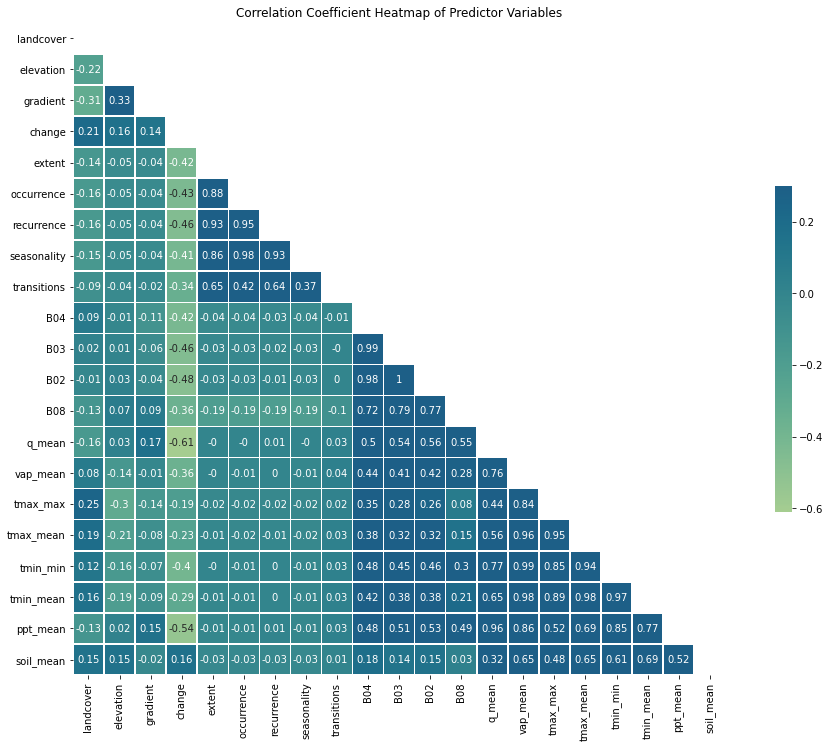

In [38]:
fig = plt.figure(figsize=(18, 12))
corr = occurence_data[['landcover', 'elevation', 'gradient', 'change', 'extent',
       'occurrence', 'recurrence', 'seasonality', 'transitions', 'B04', 'B03',
       'B02', 'B08', 'q_mean', 'vap_mean', 'tmax_max', 'tmax_mean', 'tmin_min',
       'tmin_mean', 'ppt_mean', 'soil_mean']].corr()
matrix = np.triu(corr)
sns.heatmap(round(corr,2), annot=True, mask=matrix, cmap="crest", vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})
plt.title("Correlation Coefficient Heatmap of Predictor Variables")

In [39]:
occurence_data.groupby('species')['q_mean'].mean().sort_values(ascending=False)


species
Agalychnis Callidryas        149.252968
Dendrobates Auratus          145.338296
Austrochaperina Pluvialis     74.135401
Litoria Fallax                33.377283
Ranoidea Australis            25.456959
Crinia Signifera               8.816241
Crinia Glauerti                6.614727
Xenopus Laevis                 3.976974
Chiromantis Xerampelina        3.329408
Name: q_mean, dtype: float64

In [40]:
occurence_data['eventDate']=pd.to_datetime(occurence_data['eventDate'])

In [41]:
#Time slice
time_slice = occurence_data[occurence_data['eventDate'].between("2015-01-01","2020-12-31")]

In [44]:
 
#Landcover by Countries
groupby_country = occurence_data.groupby(['country', 'species', 'landcover'])
country_landcover = pd.DataFrame(
    groupby_country.size().reset_index(name="species_count"))
country_landcover['landcover'] = country_landcover.landcover.astype(int)
country_landcover.tail()


,country,species,landcover,species_count
74,South Africa,Xenopus Laevis,2,11
75,South Africa,Xenopus Laevis,4,2
76,South Africa,Xenopus Laevis,5,1
77,South Africa,Xenopus Laevis,6,4
78,South Africa,Xenopus Laevis,7,1


In [45]:
#Map global_landcover_mapper with landcover values
country_landcover.landcover=country_landcover.landcover.map(global_landcover_mapper)
country_landcover.tail()

,country,species,landcover,species_count
74,South Africa,Xenopus Laevis,glc_trees,11
75,South Africa,Xenopus Laevis,glc_flooded_vegetation,2
76,South Africa,Xenopus Laevis,glc_crops,1
77,South Africa,Xenopus Laevis,glc_scrub,4
78,South Africa,Xenopus Laevis,glc_urban,1


(array([0, 1, 2, 3, 4, 5, 6, 7]),
 [Text(0, 0, 'glc_trees'),
  Text(1, 0, 'glc_grass'),
  Text(2, 0, 'glc_flooded_vegetation'),
  Text(3, 0, 'glc_crops'),
  Text(4, 0, 'glc_scrub'),
  Text(5, 0, 'glc_urban'),
  Text(6, 0, 'glc_water'),
  Text(7, 0, 'glc_bare_soil')])

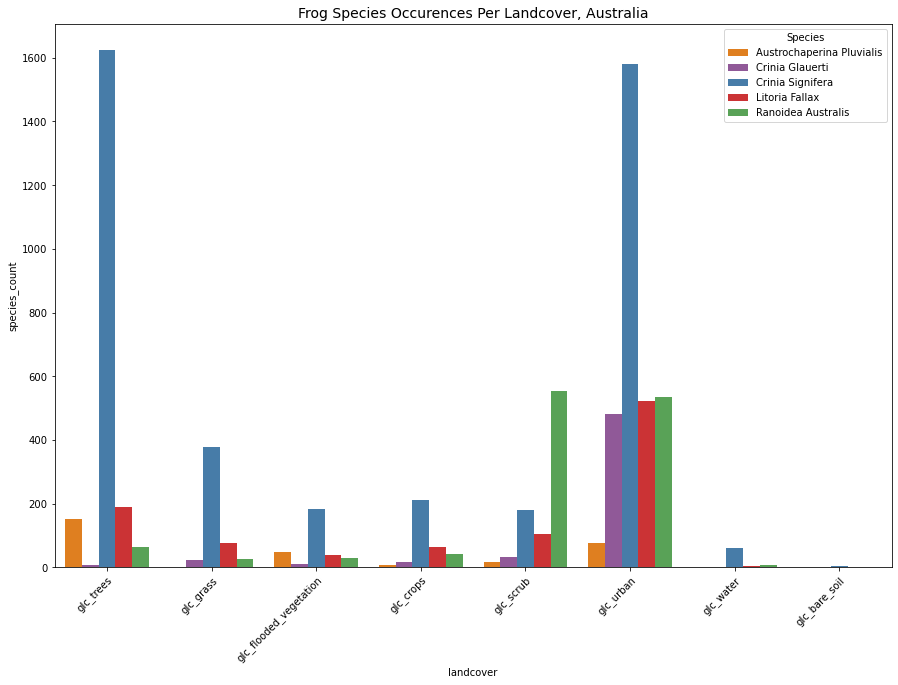

In [46]:
fig, ax = plt.subplots(figsize=(15, 10))
sns.barplot(x="landcover", y="species_count",
            hue="species", data=country_landcover[country_landcover['country'] == 'Australia'], ci=None, palette=['#ff7f00', '#984ea3', '#377eb8', '#e41a1c', '#4daf4a'])
plt.title('Frog Species Occurences Per Landcover, Australia', fontsize=14)
plt.legend(loc='upper right', title='Species')
plt.xticks(rotation=45, ha='right', va='top', rotation_mode='anchor')


(array([0, 1, 2, 3, 4, 5, 6]),
 [Text(0, 0, 'glc_water'),
  Text(1, 0, 'glc_trees'),
  Text(2, 0, 'glc_grass'),
  Text(3, 0, 'glc_flooded_vegetation'),
  Text(4, 0, 'glc_crops'),
  Text(5, 0, 'glc_scrub'),
  Text(6, 0, 'glc_urban')])

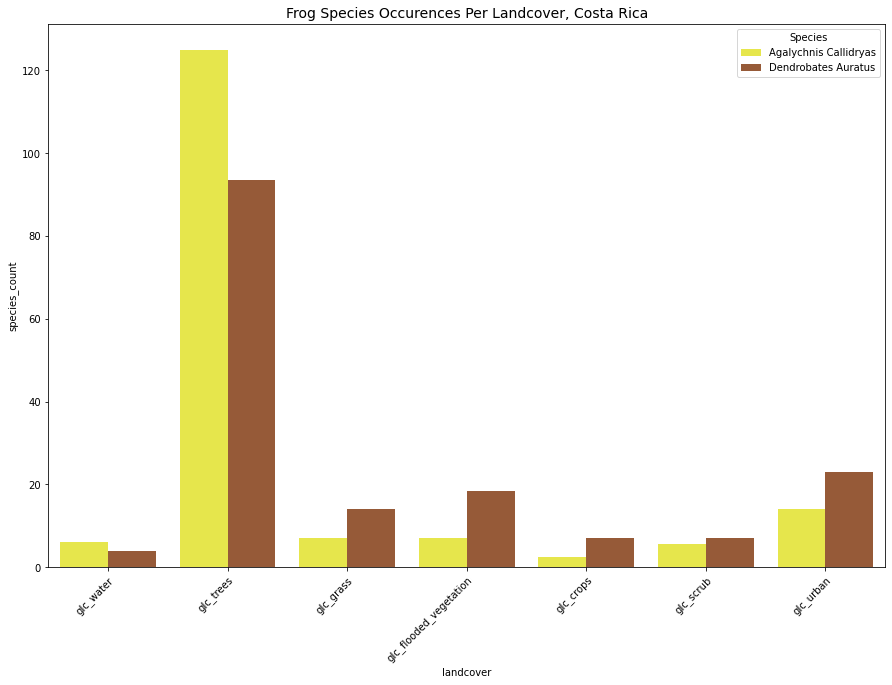

In [47]:
fig, ax = plt.subplots(figsize=(15, 10))
sns.barplot(x="landcover", y="species_count",
            hue="species", data=country_landcover[country_landcover['country'] == 'Costa Rica'], ci=None, palette=['#ffff33', '#a65628'])
plt.title('Frog Species Occurences Per Landcover, Costa Rica', fontsize=14)
plt.legend(loc='upper right', title='Species')
plt.xticks(rotation=45, ha='right', va='top', rotation_mode='anchor')


(array([0, 1, 2, 3, 4, 5, 6]),
 [Text(0, 0, 'glc_water'),
  Text(1, 0, 'glc_trees'),
  Text(2, 0, 'glc_grass'),
  Text(3, 0, 'glc_flooded_vegetation'),
  Text(4, 0, 'glc_crops'),
  Text(5, 0, 'glc_scrub'),
  Text(6, 0, 'glc_urban')])

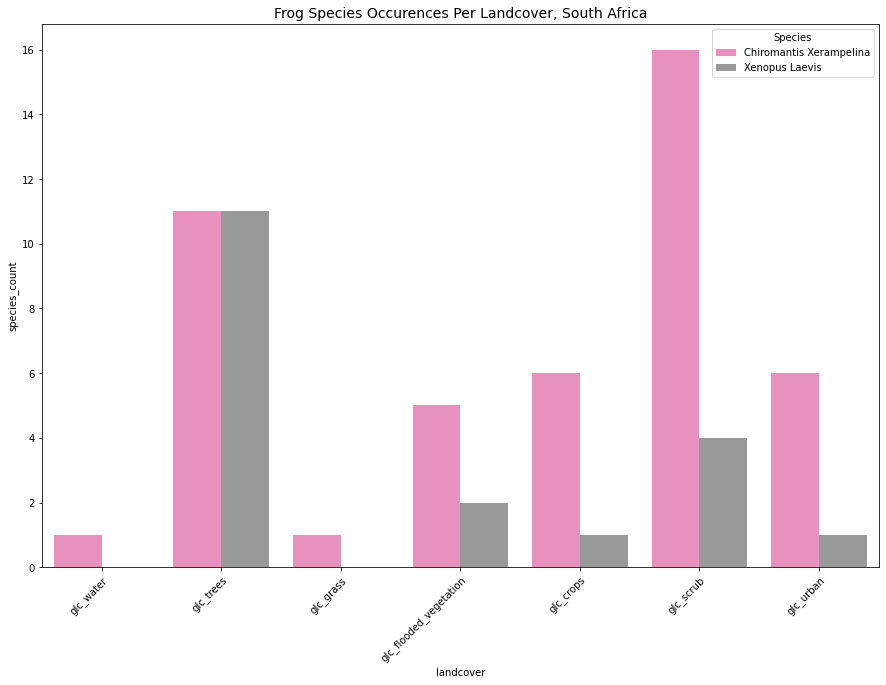

In [48]:
fig, ax = plt.subplots(figsize=(15, 10))
sns.barplot(x="landcover", y="species_count",
            hue="species", data=country_landcover[country_landcover['country'] == 'South Africa'], ci=None, palette=['#f781bf', '#999999'])
plt.title('Frog Species Occurences Per Landcover, South Africa', fontsize=14)
plt.legend(loc='upper right', title='Species')
plt.xticks(rotation=45, ha='right', va='top', rotation_mode='anchor')


In [49]:
# Define the pixel resolution for the final product
# Define the scale according to our selected crs, so we will use degrees
resolution = 10  # meters per pixel
scale = resolution / 111320.0  # degrees per pixel for crs=4326

In [50]:
# Port Macquarie, Australia
region_name = 'Port Macquarie, Australia'
# Lower-left corner (longitude, latitude) & # Upper-right corner (longitude, latitude)
min_lon, min_lat, max_lon, max_lat = (152.4, -31.9, 152.9, -31.4)
bbox = (min_lon, min_lat, max_lon, max_lat)

region_name1 = 'Victoria, Australia'
min_lon, min_lat, max_lon, max_lat = (145.125, -38, 145.625, -37.5)
bbox1 = (min_lon, min_lat, max_lon, max_lat)

region_name1 = 'Darwin, Australia'
min_lon, min_lat, max_lon, max_lat = (130.9, -12.8, 131.4, -12.3)
bbox2 = (min_lon, min_lat, max_lon, max_lat)

region_name1 = 'Western Australia, Australia'
min_lon, min_lat, max_lon, max_lat = (115.9, -31.8, 116.4, -31.3)
bbox3 = (min_lon, min_lat, max_lon, max_lat)

region_name1 = 'Queensland, Australia'
min_lon, min_lat, max_lon, max_lat = (145.2021, -17.2385, 145.7021, -16.7385)
bbox4 = (min_lon, min_lat, max_lon, max_lat)

# Costa Rica
region_name = 'Puntarenas Province, Costa Rica'
min_lon, min_lat, max_lon, max_lat = (-83.75, 8.35,-83.25, 8.85)  
bbox5 = (min_lon, min_lat, max_lon, max_lat)

region_name = 'Heredia Province, Costa Rica'
min_lon, min_lat, max_lon, max_lat = (-84.1905, 9.9575, -83.703833, 10.703667)
bbox6 = (min_lon, min_lat, max_lon, max_lat)

#South Africa
region_name = 'Hluhluwe, South Africa'
min_lon, min_lat, max_lon, max_lat = (32.00, -28.1, 32.50, -27.6)
bbox7 = (min_lon, min_lat, max_lon, max_lat)

region_name = 'KwaZulu-Natal Province, South Africa'
min_lon, min_lat, max_lon, max_lat = (30.19, -29.52, 30.69, -29.02)
bbox8 = (min_lon, min_lat, max_lon, max_lat)

region_name = 'Eshowe, South Africa'
min_lon, min_lat, max_lon, max_lat = (31.46, -28.90, 31.96, -28.40)
bbox9 = (min_lon, min_lat, max_lon, max_lat)

In [51]:
bbox_australia = {'Port Macquarie, Australia': bbox, 'Victoria, Australia': bbox1,
                  'Darwin, Australia': bbox2, 'Western Australia, Australia': bbox3, 'Queensland, Australia': bbox4}
                  
bbox_costa_rica = {'Puntarenas Province, Costa Rica': bbox5,
                   'Heredia Province, Costa Rica': bbox6}
bbox_south_afri = {'Hluhluwe, South Africa': bbox7, 'KwaZulu-Natal Province, South Africa': bbox8,
                   'Eshowe, South Africa': bbox9}


In [52]:
#make a copy of the occurence dataset
australia_occur_df = occurence_data[['decimalLatitude', 'decimalLongitude', 'species']][occurence_data['country'] ==
                                                                                        'Australia']
species_coordinates = [australia_occur_df.decimalLatitude,
                   australia_occur_df.decimalLongitude, australia_occur_df.species]
#species_coordinates = [occurence_data['decimalLatitude'][occurence_data['country'] ==
    #                                                     'Australia'], occurence_data['decimalLongitude'][occurence_data['country'] == 'Australia'], occurence_data['species'][occurence_data['country'] == 'Australia']]

# Extract latitude and longitude values from the species coordinates
lats = [coord for coord in species_coordinates[0]]
lons = [coord for coord in species_coordinates[1]]
species = [coord for coord in species_coordinates[2]]

# Get unique species categories
unique_species = list(set(species))

# Create a colormap or assign predefined colors for each species
# Replace 'tab10' with any colormap name you prefer
colormap_1 = plt.cm.get_cmap('Set1')
color_mapping = {sp: colormap_1(i) for i, sp in enumerate(unique_species)}


Number of data tiles intersecting our bounding box: 2


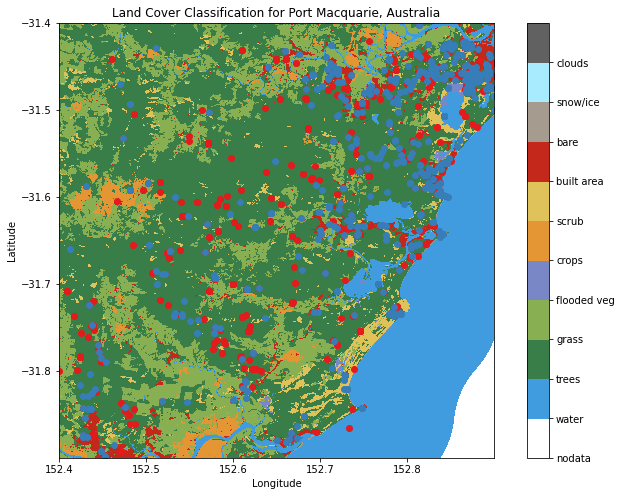

Number of data tiles intersecting our bounding box: 2


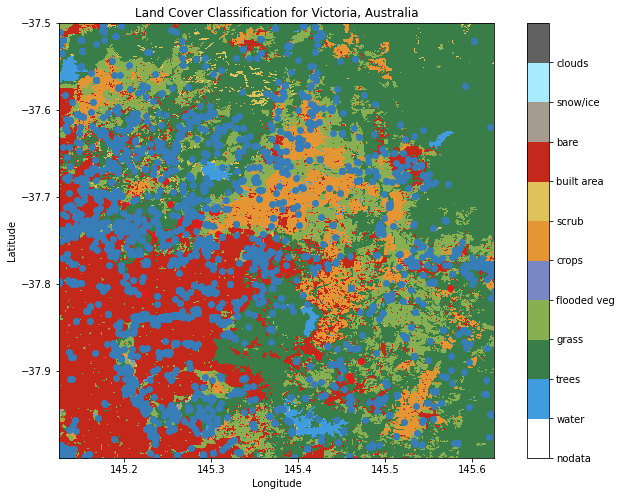

Number of data tiles intersecting our bounding box: 2


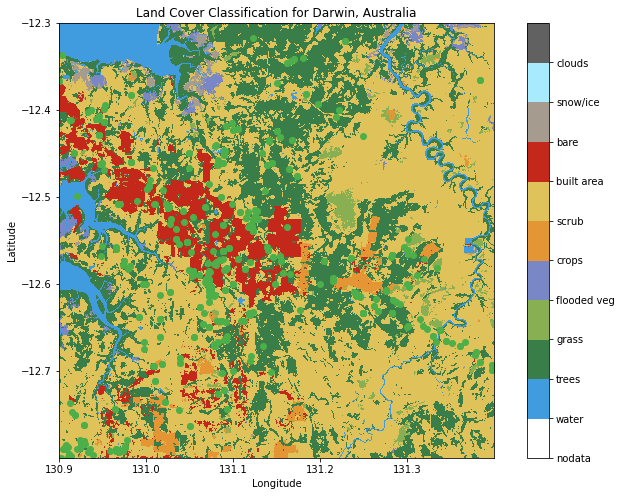

Number of data tiles intersecting our bounding box: 3


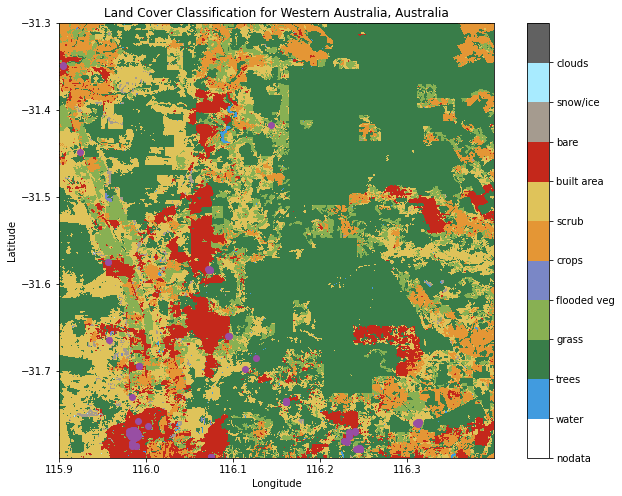

Number of data tiles intersecting our bounding box: 2


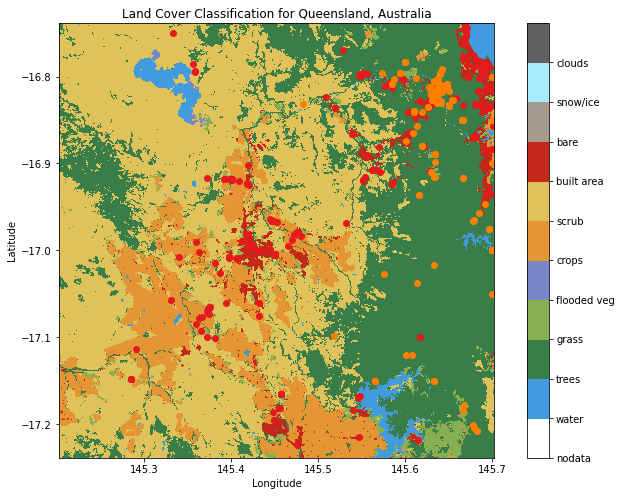

In [53]:
for i,j in bbox_australia.items():
    stac = pystac_client.Client.open(
        "https://planetarycomputer.microsoft.com/api/stac/v1")
    search = stac.search(bbox=j, collections=["io-lulc"])

    items = list(search.get_items())
    print('Number of data tiles intersecting our bounding box:', len(items))

    item = next(search.get_items())
    items = [pc.sign(item).to_dict() for item in search.get_items()]
    nodata = raster.ext(item.assets["data"]).bands[0].nodata

    data = stackstac.stack(
        items,  # use only the data from our search results
        epsg=4326,  # use common lat-lon coordinates
        resolution=scale,  # Use degrees for crs=4326
        dtype=np.ubyte,  # matches the data versus default float64
        fill_value=nodata,  # fills voids with no data
        bounds_latlon=j  # clips to our bounding box
    )

    land_cover = stackstac.mosaic(
        data, dim="time", axis=None, nodata=False).squeeze().drop("band").compute()

    # Create a custom colormap using the file metadata
    class_names = land_cover.coords["label:classes"].item()["classes"]
    class_count = len(class_names)

    with rasterio.open(pc.sign(item.assets["data"].href)) as src:
        colormap_def = src.colormap(1)  # get metadata colormap for band 1
        colormap = [np.array(colormap_def[i]) / 255 for i in range(class_count)
                    ]  # transform to matplotlib color format

    cmap = ListedColormap(colormap)

   # Plot the land cover classification
    image = land_cover.plot(
        size=8, cmap=cmap, add_colorbar=False, vmin=0, vmax=class_count)

    # Overlay the species points on the land cover plot, color-coded by species
    for sp in unique_species:
        species_lats = [lat for lat, spc in zip(lats, species) if spc == sp]
        species_lons = [lon for lon, spc in zip(lons, species) if spc == sp]
        plt.scatter(species_lons, species_lats,
                    color=colourmap_species[sp], marker='o', label=sp)

    # Add colorbar
    cbar = plt.colorbar(image)
    cbar.set_ticks(range(class_count))
    cbar.set_ticklabels(class_names)
    #plt.legend()

    plt.gca().set_aspect('equal')
    plt.title('Land Cover Classification for'+' '+str(i))
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.show()


In [54]:
#make a copy of the occurence dataset
costa_occur_df = occurence_data[['decimalLatitude', 'decimalLongitude', 'species']][occurence_data['country'] ==
                                                                                        'Costa Rica']
species_coordinates = [costa_occur_df.decimalLatitude,
                       costa_occur_df.decimalLongitude, costa_occur_df.species]


# Extract latitude and longitude values from the species coordinates
lats = [coord for coord in species_coordinates[0]]
lons = [coord for coord in species_coordinates[1]]
species = [coord for coord in species_coordinates[2]]

# Get unique species categories
unique_species = list(set(species))

# Create a colormap or assign predefined colors for each species
# Replace 'tab10' with any colormap name you prefer
colormap_1 = plt.cm.get_cmap('Set1')
color_mapping = {sp: colormap_1(i) for i, sp in enumerate(unique_species)}


Number of data tiles intersecting our bounding box: 3


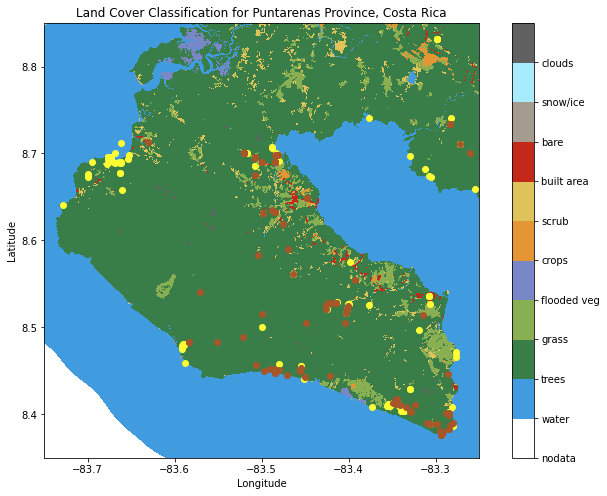

Number of data tiles intersecting our bounding box: 2


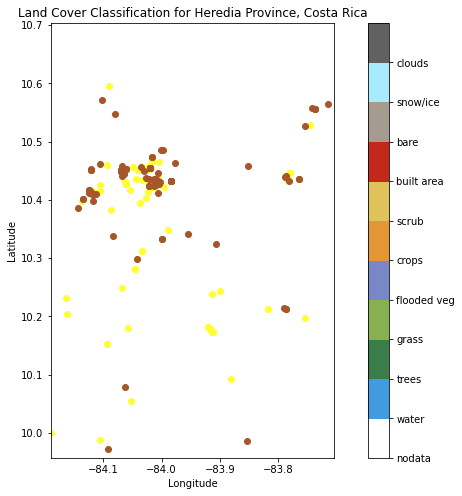

In [55]:
for i, j in bbox_costa_rica.items():
    stac = pystac_client.Client.open(
        "https://planetarycomputer.microsoft.com/api/stac/v1")
    search = stac.search(bbox=j, collections=["io-lulc"])

    items = list(search.get_items())
    print('Number of data tiles intersecting our bounding box:', len(items))

    item = next(search.get_items())
    items = [pc.sign(item).to_dict() for item in search.get_items()]
    nodata = raster.ext(item.assets["data"]).bands[0].nodata

    data = stackstac.stack(
        items,  # use only the data from our search results
        epsg=4326,  # use common lat-lon coordinates
        resolution=scale,  # Use degrees for crs=4326
        dtype=np.ubyte,  # matches the data versus default float64
        fill_value=nodata,  # fills voids with no data
        bounds_latlon=j  # clips to our bounding box
    )

    land_cover = stackstac.mosaic(
        data, dim="time", axis=None, nodata=False).squeeze().drop("band").compute()

    # Create a custom colormap using the file metadata
    class_names = land_cover.coords["label:classes"].item()["classes"]
    class_count = len(class_names)

    with rasterio.open(pc.sign(item.assets["data"].href)) as src:
        colormap_def = src.colormap(1)  # get metadata colormap for band 1
        colormap = [np.array(colormap_def[i]) / 255 for i in range(class_count)
                    ]  # transform to matplotlib color format

    cmap = ListedColormap(colormap)

    # Plot the land cover classification
    image = land_cover.plot(
        size=8, cmap=cmap, add_colorbar=False, vmin=0, vmax=class_count)

    # Overlay the species points on the land cover plot, color-coded by species
    for sp in unique_species:
        species_lats = [lat for lat, spc in zip(lats, species) if spc == sp]
        species_lons = [lon for lon, spc in zip(lons, species) if spc == sp]
        plt.scatter(species_lons, species_lats,
                    color=colourmap_species[sp], marker='o', label=sp)

    # Add colorbar
    cbar = plt.colorbar(image)
    cbar.set_ticks(range(class_count))
    cbar.set_ticklabels(class_names)
    #plt.legend()

    plt.gca().set_aspect('equal')
    plt.title('Land Cover Classification for'+' '+str(i))
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.show()


In [56]:
#make a copy of the occurence dataset
sa_occur_df = occurence_data[['decimalLatitude', 'decimalLongitude', 'species']][occurence_data['country'] ==
                                                                                        'South Africa']
species_coordinates = [sa_occur_df.decimalLatitude,
                       sa_occur_df.decimalLongitude, sa_occur_df.species]


# Extract latitude and longitude values from the species coordinates
lats = [coord for coord in species_coordinates[0]]
lons = [coord for coord in species_coordinates[1]]
species = [coord for coord in species_coordinates[2]]

# Get unique species categories
unique_species = list(set(species))

# Create a colormap or assign predefined colors for each species
# Replace 'tab10' with any colormap name you prefer
colormap_1 = plt.cm.get_cmap('Set1')
color_mapping = {sp: colormap_1(i) for i, sp in enumerate(unique_species)}


Number of data tiles intersecting our bounding box: 2


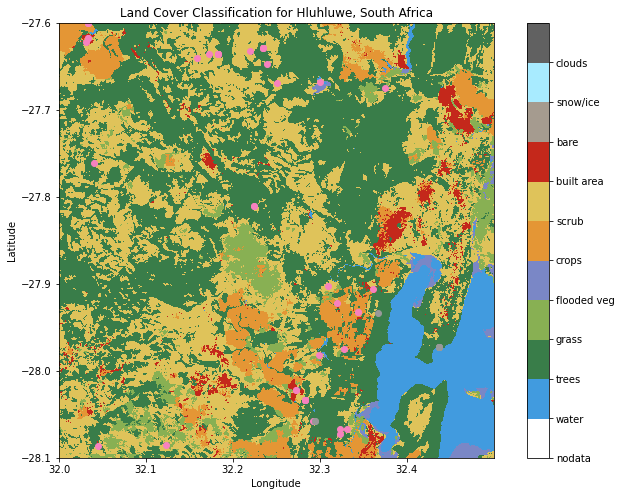

Number of data tiles intersecting our bounding box: 2


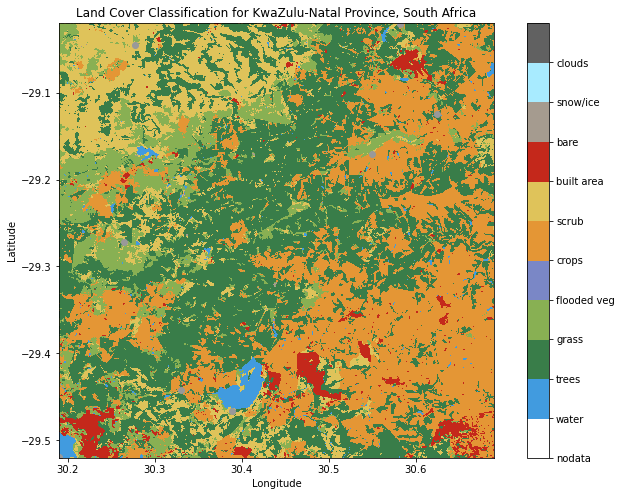

Number of data tiles intersecting our bounding box: 2


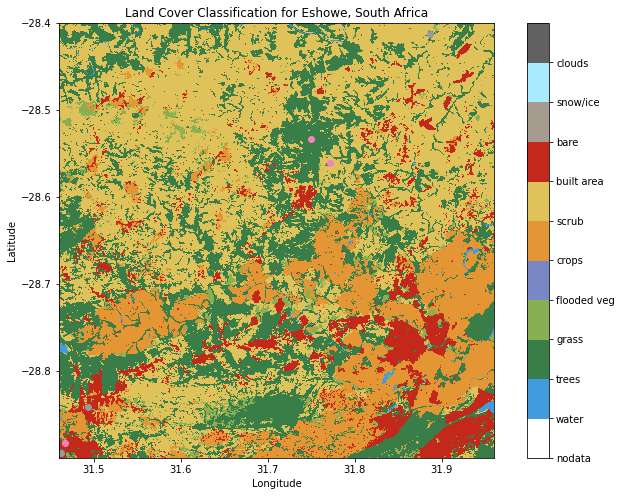

In [57]:
for i, j in bbox_south_afri.items():
    stac = pystac_client.Client.open(
        "https://planetarycomputer.microsoft.com/api/stac/v1")
    search = stac.search(bbox=j, collections=["io-lulc"])

    items = list(search.get_items())
    print('Number of data tiles intersecting our bounding box:', len(items))

    item = next(search.get_items())
    items = [pc.sign(item).to_dict() for item in search.get_items()]
    nodata = raster.ext(item.assets["data"]).bands[0].nodata

    data = stackstac.stack(
        items,  # use only the data from our search results
        epsg=4326,  # use common lat-lon coordinates
        resolution=scale,  # Use degrees for crs=4326
        dtype=np.ubyte,  # matches the data versus default float64
        fill_value=nodata,  # fills voids with no data
        bounds_latlon=j  # clips to our bounding box
    )

    land_cover = stackstac.mosaic(
        data, dim="time", axis=None, nodata=False).squeeze().drop("band").compute()

    # Create a custom colormap using the file metadata
    class_names = land_cover.coords["label:classes"].item()["classes"]
    class_count = len(class_names)

    with rasterio.open(pc.sign(item.assets["data"].href)) as src:
        colormap_def = src.colormap(1)  # get metadata colormap for band 1
        colormap = [np.array(colormap_def[i]) / 255 for i in range(class_count)
                    ]  # transform to matplotlib color format

    cmap = ListedColormap(colormap)

    # Plot the land cover classification
    image = land_cover.plot(
        size=8, cmap=cmap, add_colorbar=False, vmin=0, vmax=class_count)

    # Overlay the species points on the land cover plot, color-coded by species
    for sp in unique_species:
        species_lats = [lat for lat, spc in zip(lats, species) if spc == sp]
        species_lons = [lon for lon, spc in zip(lons, species) if spc == sp]
        plt.scatter(species_lons, species_lats,
                    color=colourmap_species[sp], marker='o', label=sp)

    # Add colorbar
    cbar = plt.colorbar(image)
    cbar.set_ticks(range(class_count))
    cbar.set_ticklabels(class_names)
    #plt.legend()

    plt.gca().set_aspect('equal')
    plt.title('Land Cover Classification for'+' '+str(i))
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.show()


In [58]:
#preprocess data
#Create dummies for landcover and transitions
occurence_data = (
    occurence_data
    .merge(
        pd.get_dummies(
            occurence_data.landcover.astype(int).map(global_landcover_mapper)
        ).assign(key=occurence_data.key),
        on='key'
    )
    .drop("landcover", 1)
    .merge(
        pd.get_dummies(
            occurence_data.transitions.astype(int).map(
                surface_water_transitions_mapper)
        ).assign(key=occurence_data.key),
        on='key'
    )
    .drop("transitions", 1)
)
occurence_data.head()


,Unnamed: 0,gbifID,eventDate,country,continent,stateProvince,decimalLatitude,decimalLongitude,species,key,...,sw_tran_ephemeral_permanent,sw_tran_ephemeral_seasonal,sw_tran_lost_permanent,sw_tran_lost_seasonal,sw_tran_new_permanent,sw_tran_new_seasonal,sw_tran_permanent,sw_tran_permanent_to_seasonal,sw_tran_seasonal,sw_tran_seasonal_to_permanent
0,0,2818667399,2014-01-16 13:30:00,Australia,Australia,New South Wales,-31.804450,152.728649,Litoria Fallax,0,...,0,0,0,0,0,0,0,0,0,0
1,1,1071587460,2005-10-18 00:00:00,Australia,Australia,New South Wales,-31.458809,152.872052,Litoria Fallax,1,...,0,0,0,0,0,0,0,0,0,0
2,2,2806337299,2020-04-14 00:00:00,Australia,Australia,New South Wales,-31.467921,152.873221,Crinia Signifera,2,...,0,0,0,0,0,0,0,0,0,0
3,3,1072127779,1995-01-06 00:00:00,Australia,Australia,New South Wales,-31.752803,152.585086,Litoria Fallax,3,...,0,0,0,0,0,0,0,0,0,0
4,4,1072032944,2003-07-23 00:00:00,Australia,Australia,New South Wales,-31.592781,152.837717,Crinia Signifera,4,...,0,0,0,0,0,0,0,0,0,0


In [59]:
len(occurence_data)

9214

In [60]:
occurence_data.shape

(9214, 47)

In [61]:
test = occurence_data.copy()


(array([0, 1, 2, 3, 4, 5, 6, 7, 8]),
 [Text(0, 0, 'Litoria Fallax'),
  Text(1, 0, 'Crinia Signifera'),
  Text(2, 0, 'Ranoidea Australis'),
  Text(3, 0, 'Crinia Glauerti'),
  Text(4, 0, 'Austrochaperina Pluvialis'),
  Text(5, 0, 'Agalychnis Callidryas'),
  Text(6, 0, 'Dendrobates Auratus'),
  Text(7, 0, 'Chiromantis Xerampelina'),
  Text(8, 0, 'Xenopus Laevis')])

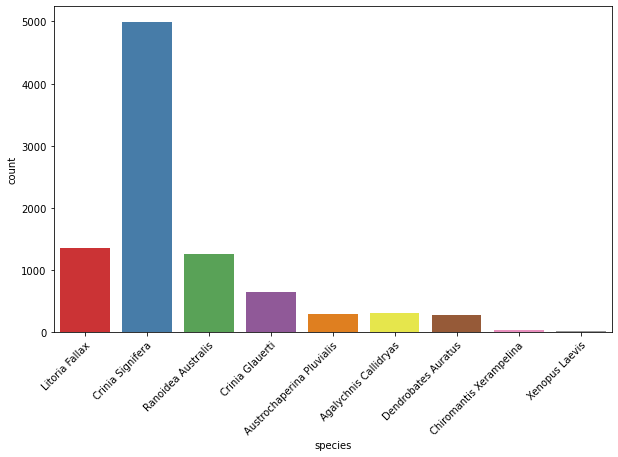

In [62]:
# Bar charts
fig, ax = plt.subplots(figsize=(10, 6), sharey=True, sharex=True)
#balanced_bar_data = balanced_frogs.species.value_counts()
sns.countplot(x=occurence_data.species, palette='Set1')
#ax.set_title('Imbalanced Occurence Dataset')
plt.xticks(rotation=45, ha='right', va='top', rotation_mode='anchor')

In [63]:
#Data set is imbalanced
# Separate the predictor variables from the response
features = (occurence_data.drop(['gbifID', 'eventDate',
            'species', 'country', 'continent', 'stateProvince', 'key', 'Unnamed: 0'], 1))
species = occurence_data.species


In [64]:
features.head()

,decimalLatitude,decimalLongitude,elevation,gradient,change,extent,occurrence,recurrence,seasonality,B04,...,sw_tran_ephemeral_permanent,sw_tran_ephemeral_seasonal,sw_tran_lost_permanent,sw_tran_lost_seasonal,sw_tran_new_permanent,sw_tran_new_seasonal,sw_tran_permanent,sw_tran_permanent_to_seasonal,sw_tran_seasonal,sw_tran_seasonal_to_permanent
0,-31.804450,152.728649,9.157680,0.599853,253.0,0.0,0.0,0.0,0.0,819.0,...,0,0,0,0,0,0,0,0,0,0
1,-31.458809,152.872052,12.447579,3.450369,253.0,0.0,0.0,0.0,0.0,1354.0,...,0,0,0,0,0,0,0,0,0,0
2,-31.467921,152.873221,15.234476,1.841235,253.0,0.0,0.0,0.0,0.0,574.0,...,0,0,0,0,0,0,0,0,0,0
3,-31.752803,152.585086,120.087341,21.286922,253.0,0.0,0.0,0.0,0.0,2116.0,...,0,0,0,0,0,0,0,0,0,0
4,-31.592781,152.837717,25.947113,7.681154,253.0,0.0,0.0,0.0,0.0,363.0,...,0,0,0,0,0,0,0,0,0,0


In [65]:
features.tail()

,decimalLatitude,decimalLongitude,elevation,gradient,change,extent,occurrence,recurrence,seasonality,B04,...,sw_tran_ephemeral_permanent,sw_tran_ephemeral_seasonal,sw_tran_lost_permanent,sw_tran_lost_seasonal,sw_tran_new_permanent,sw_tran_new_seasonal,sw_tran_permanent,sw_tran_permanent_to_seasonal,sw_tran_seasonal,sw_tran_seasonal_to_permanent
9209,-28.894677,31.462758,504.975037,7.194518,253.0,0.0,0.0,0.0,0.0,249.5,...,0,0,0,0,0,0,0,0,0,0
9210,-28.883330,31.466670,531.584717,3.628757,253.0,0.0,0.0,0.0,0.0,618.0,...,0,0,0,0,0,0,0,0,0,0
9211,-28.842000,31.493667,421.096161,8.656943,253.0,0.0,0.0,0.0,0.0,715.0,...,0,0,0,0,0,0,0,0,0,0
9212,-28.412500,31.886111,70.910347,5.089491,253.0,0.0,0.0,0.0,0.0,476.5,...,0,0,0,0,0,0,0,0,0,0
9213,-28.533333,31.750000,282.902527,6.872763,253.0,0.0,0.0,0.0,0.0,248.5,...,0,0,0,0,0,0,0,0,0,0


In [66]:
print(species.head())
print(species.tail())

0      Litoria Fallax
1      Litoria Fallax
2    Crinia Signifera
3      Litoria Fallax
4    Crinia Signifera
Name: species, dtype: object
9209             Xenopus Laevis
9210    Chiromantis Xerampelina
9211             Xenopus Laevis
9212             Xenopus Laevis
9213    Chiromantis Xerampelina
Name: species, dtype: object


In [67]:
print(test.species.head())
print(test.species.tail())

0      Litoria Fallax
1      Litoria Fallax
2    Crinia Signifera
3      Litoria Fallax
4    Crinia Signifera
Name: species, dtype: object
9209             Xenopus Laevis
9210    Chiromantis Xerampelina
9211             Xenopus Laevis
9212             Xenopus Laevis
9213    Chiromantis Xerampelina
Name: species, dtype: object


In [68]:
from imblearn.over_sampling import SMOTE
smote_ = SMOTE(random_state=0)
X_resampled, y_resampled = smote_.fit_resample(features, species)

In [69]:
X_resampled.head()



,decimalLatitude,decimalLongitude,elevation,gradient,change,extent,occurrence,recurrence,seasonality,B04,...,sw_tran_ephemeral_permanent,sw_tran_ephemeral_seasonal,sw_tran_lost_permanent,sw_tran_lost_seasonal,sw_tran_new_permanent,sw_tran_new_seasonal,sw_tran_permanent,sw_tran_permanent_to_seasonal,sw_tran_seasonal,sw_tran_seasonal_to_permanent
0,-31.804450,152.728649,9.157680,0.599853,253.0,0.0,0.0,0.0,0.0,819.0,...,0,0,0,0,0,0,0,0,0,0
1,-31.458809,152.872052,12.447579,3.450369,253.0,0.0,0.0,0.0,0.0,1354.0,...,0,0,0,0,0,0,0,0,0,0
2,-31.467921,152.873221,15.234476,1.841235,253.0,0.0,0.0,0.0,0.0,574.0,...,0,0,0,0,0,0,0,0,0,0
3,-31.752803,152.585086,120.087341,21.286922,253.0,0.0,0.0,0.0,0.0,2116.0,...,0,0,0,0,0,0,0,0,0,0
4,-31.592781,152.837717,25.947113,7.681154,253.0,0.0,0.0,0.0,0.0,363.0,...,0,0,0,0,0,0,0,0,0,0


In [70]:
y_resampled.head()

0      Litoria Fallax
1      Litoria Fallax
2    Crinia Signifera
3      Litoria Fallax
4    Crinia Signifera
Name: species, dtype: object

In [71]:
#Merge Lat and lon based on index create for the X_test
resampled_occurence_data = pd.merge(
    X_resampled, y_resampled, left_index=True, right_index=True)
resampled_occurence_data.head()

,decimalLatitude,decimalLongitude,elevation,gradient,change,extent,occurrence,recurrence,seasonality,B04,...,sw_tran_ephemeral_seasonal,sw_tran_lost_permanent,sw_tran_lost_seasonal,sw_tran_new_permanent,sw_tran_new_seasonal,sw_tran_permanent,sw_tran_permanent_to_seasonal,sw_tran_seasonal,sw_tran_seasonal_to_permanent,species
0,-31.804450,152.728649,9.157680,0.599853,253.0,0.0,0.0,0.0,0.0,819.0,...,0,0,0,0,0,0,0,0,0,Litoria Fallax
1,-31.458809,152.872052,12.447579,3.450369,253.0,0.0,0.0,0.0,0.0,1354.0,...,0,0,0,0,0,0,0,0,0,Litoria Fallax
2,-31.467921,152.873221,15.234476,1.841235,253.0,0.0,0.0,0.0,0.0,574.0,...,0,0,0,0,0,0,0,0,0,Crinia Signifera
3,-31.752803,152.585086,120.087341,21.286922,253.0,0.0,0.0,0.0,0.0,2116.0,...,0,0,0,0,0,0,0,0,0,Litoria Fallax
4,-31.592781,152.837717,25.947113,7.681154,253.0,0.0,0.0,0.0,0.0,363.0,...,0,0,0,0,0,0,0,0,0,Crinia Signifera


In [72]:
#Save to CSV
occurence_data.to_csv(storage_path+'occurence_data_csv', sep='\t')
resampled_occurence_data.to_csv(storage_path+'modelling_data_csv', sep='\t')
